<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/5/58/Uber_logo_2018.svg/1024px-Uber_logo_2018.svg.png" alt="UBER LOGO" width="50%" />

# UBER Pickups 

## Company's Description 📇

<a href="http://uber.com/" target="_blank">Uber</a> is one of the most famous startup in the world. It started as a ride-sharing application for people who couldn't afford a taxi. Now, Uber expanded its activities to Food Delivery with <a href="https://www.ubereats.com/fr-en" target="_blank">Uber Eats</a>, package delivery, freight transportation and even urban transportation with <a href="https://www.uber.com/fr/en/ride/uber-bike/" target="_blank"> Jump Bike</a> and <a href="https://www.li.me/" target="_blank"> Lime </a> that the company funded. 


The company's goal is to revolutionize transportation accross the globe. It operates now on about 70 countries and 900 cities and generates over $14 billion revenue! 😮


## Project 🚧

One of the main pain point that Uber's team found is that sometimes drivers are not around when users need them. For example, a user might be in San Francisco's Financial District whereas Uber drivers are looking for customers in Castro.  

(If you are not familiar with the bay area, check out <a href="https://www.google.com/maps/place/San+Francisco,+CA,+USA/@37.7515389,-122.4567213,13.43z/data=!4m5!3m4!1s0x80859a6d00690021:0x4a501367f076adff!8m2!3d37.7749295!4d-122.4194155" target="_blank">Google Maps</a>)

Eventhough both neighborhood are not that far away, users would still have to wait 10 to 15 minutes before being picked-up, which is too long. Uber's research shows that users accept to wait 5-7 minutes, otherwise they would cancel their ride. 

Therefore, Uber's data team would like to work on a project where **their app would recommend hot-zones in major cities to be in at any given time of day.**  

## Goals 🎯

Uber already has data about pickups in major cities. Your objective is to create algorithms that will determine where are the hot-zones that drivers should be in. Therefore you will:

* Create an algorithm to find hot zones 
* Visualize results on a nice dashboard 

## Scope of this project 🖼️

To start off, Uber wants to try this feature in New York city. Therefore you will only focus on this city. Data can be found here: 

👉👉<a href="https://full-stack-bigdata-datasets.s3.eu-west-3.amazonaws.com/Machine+Learning+non+Supervis%C3%A9/Projects/uber-trip-data.zip" target="_blank"> Uber Trip Data</a> 👈👈

**You only need to focus on New York City for this project**

## Helpers 🦮

To help you achieve this project, here are a few tips that should help you: 

### Clustering is your friend 

Clustering technics are a perfect fit for the job. Think about it, all the pickup locations can be gathered into different clusters. You can then use **cluster coordinates to pin hot zones** 😉
    

### Create maps with `plotly` 

Check out <a href="https://plotly.com/" target="_blank">Plotly</a> documentation, you can create maps and populate them easily. Obviously, there are other libraries but this one should do the job pretty well. 


### Start small grow big 

Eventhough Uber wants to have hot-zones per hour and per day of week, you should first **start small**. Pick one day at a given hour and **then start to generalize** your approach. 

## Deliverable 📬

To complete this project, your team should: 

* Have a map with hot-zones using any python library (`plotly` or anything else). 
* You should **at least** describe hot-zones per day of week. 
* Compare results with **at least** two unsupervised algorithms like KMeans and DBScan. 

Your maps should look something like this: 

<img src="https://full-stack-assets.s3.eu-west-3.amazonaws.com/images/Clusters_uber_pickups.png" alt="Uber Cluster Map" />

Concaténer tous les dataframes de 2014, essayer de faire des clusters

# Introduction

Context

This project explores Uber ride pickup data in New York City during 2014, with the goal of identifying spatio-temporal patterns of user activity.
The dataset contains millions of GPS points representing the location and time of each Uber pickup.

Understanding where and when ride demand peaks can help optimize driver allocation, dynamic pricing, and urban mobility planning.

Objectives

Identify daily and weekly temporal trends in ride demand.

Detect geographical hotspots where Uber activity is most concentrated.

Apply unsupervised machine learning algorithms to uncover natural clusters without predefined labels.

Methods

Exploratory Data Analysis (EDA) to explore temporal and spatial patterns.

K-Means clustering to segment geographical areas into high-activity zones.

DBSCAN clustering to detect natural density-based clusters and noise (outliers).

Visualization with GeoPandas and Contextily to map results on real city coordinates.

Expected outcomes

The analysis aims to highlight key mobility zones and peak demand periods, providing insights into how urban activity and transportation demand evolve across time and space.

# Let's Roll

Libraries

In [2]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import contextily as ctx
from shapely.geometry import Point
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.colors as mcolors
from matplotlib.cm import get_cmap
import matplotlib.patches as mpatches
import matplotlib as mpl
from sklearn.metrics import silhouette_score
import plotly.express as px

Charge and concatenate the csv files from 2014

In [3]:
path = "/Users/andreealouison/Documents/Jedha/PROJETS/Module6_Unsupervised_ML_Uber_NorthFace/Uber/uber-trip-data/"

files = [
    f"{path}uber-raw-data-apr14.csv",
    f"{path}uber-raw-data-may14.csv",
    f"{path}uber-raw-data-jun14.csv",
    f"{path}uber-raw-data-jul14.csv",
    f"{path}uber-raw-data-aug14.csv",
    f"{path}uber-raw-data-sep14.csv",
]

df = pd.concat([pd.read_csv(f) for f in files], ignore_index=True)

## Overview 2014

In [4]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [5]:
df.shape

(4534327, 4)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4534327 entries, 0 to 4534326
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 138.4+ MB


## Preprocessing

In [7]:
# Convert "Date/Time" to datetime object
df["Date/Time"] = pd.to_datetime(df["Date/Time"], errors="coerce")

# Create temporal features
df["hour"] = df["Date/Time"].dt.hour
df["day"] = df["Date/Time"].dt.day
df["month"] = df["Date/Time"].dt.month
df["weekday"] = df["Date/Time"].dt.day_name()
df["is_weekend"] = df["Date/Time"].dt.weekday >= 5

# Check
df.tail()


,Date/Time,Lat,Lon,Base,hour,day,month,weekday,is_weekend
4534322,2014-09-30 22:57:00,40.7668,-73.9845,B02764,22,30,9,Tuesday,False
4534323,2014-09-30 22:57:00,40.6911,-74.1773,B02764,22,30,9,Tuesday,False
4534324,2014-09-30 22:58:00,40.8519,-73.9319,B02764,22,30,9,Tuesday,False
4534325,2014-09-30 22:58:00,40.7081,-74.0066,B02764,22,30,9,Tuesday,False
4534326,2014-09-30 22:58:00,40.7140,-73.9496,B02764,22,30,9,Tuesday,False


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4534327 entries, 0 to 4534326
Data columns (total 9 columns):
 #   Column      Dtype         
---  ------      -----         
 0   Date/Time   datetime64[ns]
 1   Lat         float64       
 2   Lon         float64       
 3   Base        object        
 4   hour        int32         
 5   day         int32         
 6   month       int32         
 7   weekday     object        
 8   is_weekend  bool          
dtypes: bool(1), datetime64[ns](1), float64(2), int32(3), object(2)
memory usage: 229.2+ MB


# Temporal EDA

### Number of Uber Pickups per Hour from Monday to Sunday

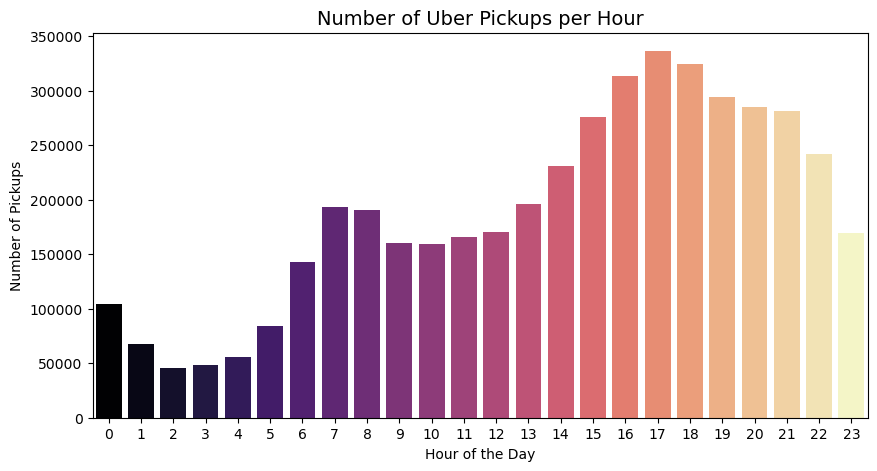

In [9]:
plt.figure(figsize=(10,5))
sns.countplot(x="hour", hue="hour", data=df, palette="magma", legend=False)

plt.title("Number of Uber Pickups per Hour", fontsize=14)
plt.xlabel("Hour of the Day")
plt.ylabel("Number of Pickups")
plt.show()

### Number of Uber Pickups per Hour from Monday to Friday and Saturday/ Sunday

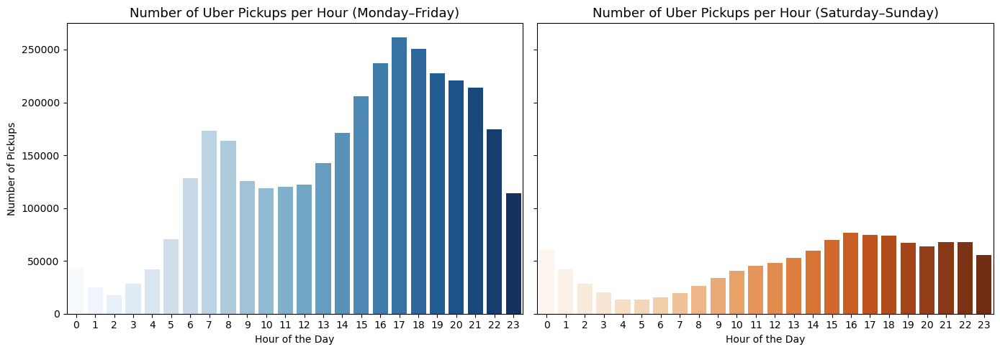

In [10]:
# Split the data
df_weekday = df[df["is_weekend"] == False]
df_weekend = df[df["is_weekend"] == True]

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14,5), sharey=True)

# Weekday histogram
sns.countplot(
    x="hour",
    data=df_weekday,
    hue="hour",
    palette="Blues",
    legend=False,
    ax=axes[0]
)
axes[0].set_title("Number of Uber Pickups per Hour (Monday–Friday)", fontsize=13)
axes[0].set_xlabel("Hour of the Day")
axes[0].set_ylabel("Number of Pickups")

# Weekend histogram
sns.countplot(
    x="hour",
    data=df_weekend,
    hue="hour",
    palette="Oranges",
    legend=False,
    ax=axes[1]
)
axes[1].set_title("Number of Uber Pickups per Hour (Saturday–Sunday)", fontsize=13)
axes[1].set_xlabel("Hour of the Day")
axes[1].set_ylabel("")

plt.tight_layout()
plt.show()


### Number of Uber Pickups per Hour – Weekdays and Weekend (Stacked)

<Figure size 1000x600 with 0 Axes>

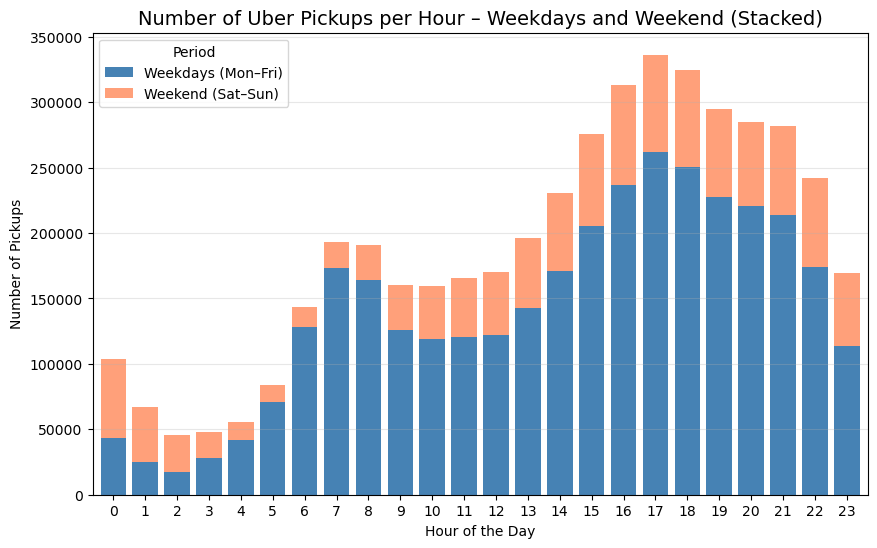

In [11]:
# Compute hourly pickups for weekdays and weekend
hourly_counts = df.groupby(["hour", "is_weekend"]).size().unstack(fill_value=0)

# Plot stacked bars
plt.figure(figsize=(10,6))
hourly_counts.plot(
    kind="bar",
    stacked=True,
    color=["steelblue", "#FFA07A"],
    width=0.8,
    figsize=(10,6)
)

plt.title("Number of Uber Pickups per Hour – Weekdays and Weekend (Stacked)", fontsize=14)
plt.xlabel("Hour of the Day")
plt.ylabel("Number of Pickups")
plt.legend(["Weekdays (Mon–Fri)", "Weekend (Sat–Sun)"], title="Period")
plt.xticks(rotation=0)
plt.grid(axis="y", alpha=0.3)
plt.show()


### Proportion of Weekend vs Weekday Pickups per Hour

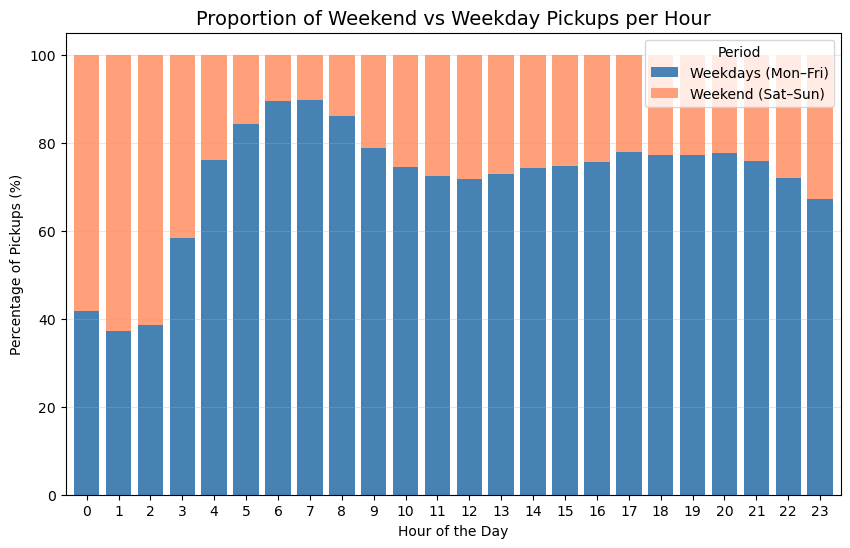

In [12]:
# Compute hourly pickups (same as before)
hourly_counts = df.groupby(["hour", "is_weekend"]).size().unstack(fill_value=0)

# Convert to percentages
hourly_percent = hourly_counts.div(hourly_counts.sum(axis=1), axis=0) * 100

# Plot 100% stacked bar chart
ax = hourly_percent.plot(
    kind="bar",
    stacked=True,
    color=["steelblue", "#FFA07A"],
    width=0.8,
    figsize=(10,6)
)

plt.title("Proportion of Weekend vs Weekday Pickups per Hour", fontsize=14)
plt.xlabel("Hour of the Day")
plt.ylabel("Percentage of Pickups (%)")
plt.legend(["Weekdays (Mon–Fri)", "Weekend (Sat–Sun)"], title="Period")
plt.xticks(rotation=0)
plt.grid(axis="y", alpha=0.3)
plt.show()


### Number of Uber Pickups per Day of the Week

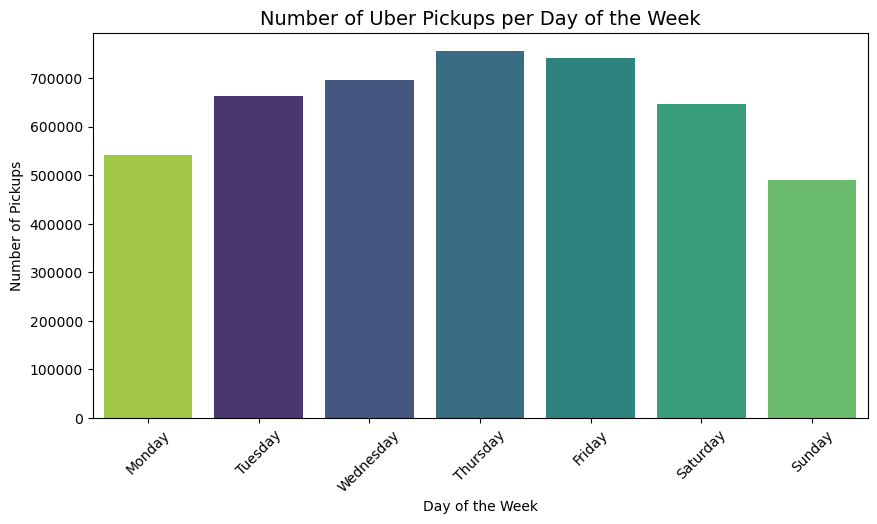

In [13]:
plt.figure(figsize=(10,5))
sns.countplot(
    x="weekday", 
    data=df, 
    order=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"],
    hue="weekday",
    palette="viridis",
    legend=False
)

plt.title("Number of Uber Pickups per Day of the Week", fontsize=14)
plt.xlabel("Day of the Week")
plt.ylabel("Number of Pickups")
plt.xticks(rotation=45)
plt.show()


### Pick-ups heatmap

This heatmap clearly highlights the morning and evening peaks on weekdays and the more diffuse activity on weekends. It helps visualize daily mobility rhythms in NYC.

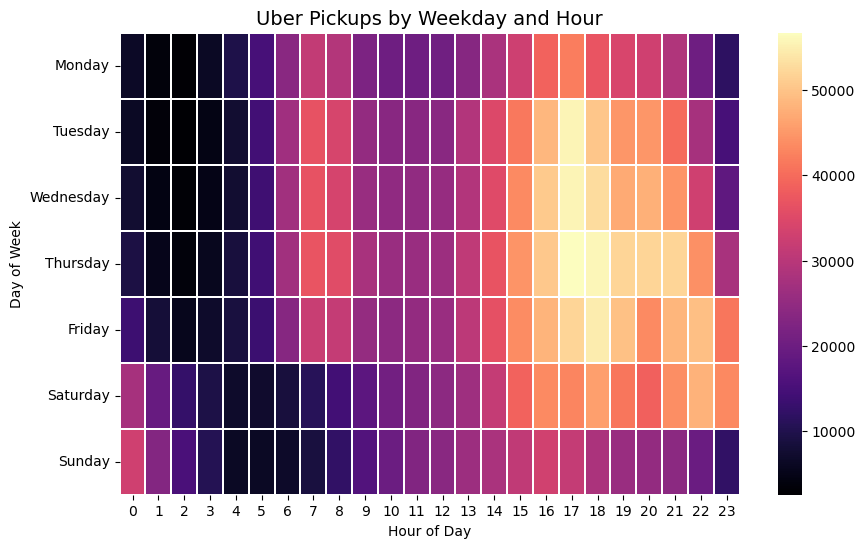

In [14]:
# Prepare data for heatmap
heatmap_data = df.groupby(["weekday", "hour"]).size().unstack(fill_value=0)

# Reorder weekdays for readability
weekday_order = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
heatmap_data = heatmap_data.reindex(weekday_order)

# Plot heatmap
plt.figure(figsize=(10,6))
sns.heatmap(heatmap_data, cmap="magma", linewidths=0.3)
plt.title("Uber Pickups by Weekday and Hour", fontsize=14)
plt.xlabel("Hour of Day")
plt.ylabel("Day of Week")
plt.show()


# Geograpical EDA

### Geographical Distribution of Uber Pickups (Sample 50k)

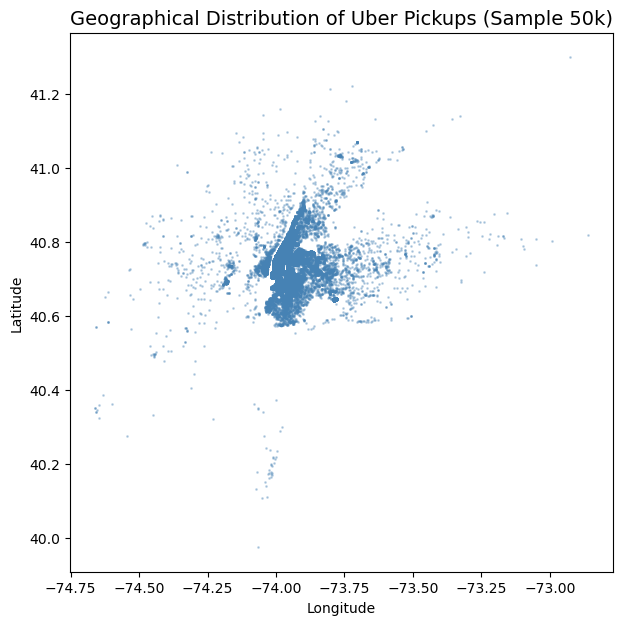

In [40]:
sample = df.sample(150000, random_state=42)
plt.figure(figsize=(7,7))
plt.scatter(sample["Lon"], sample["Lat"], s=1, alpha=0.3, color="steelblue")
plt.title("Geographical Distribution of Uber Pickups (Sample 50k)", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()


### Uber Pickups in New York City (50k sample)

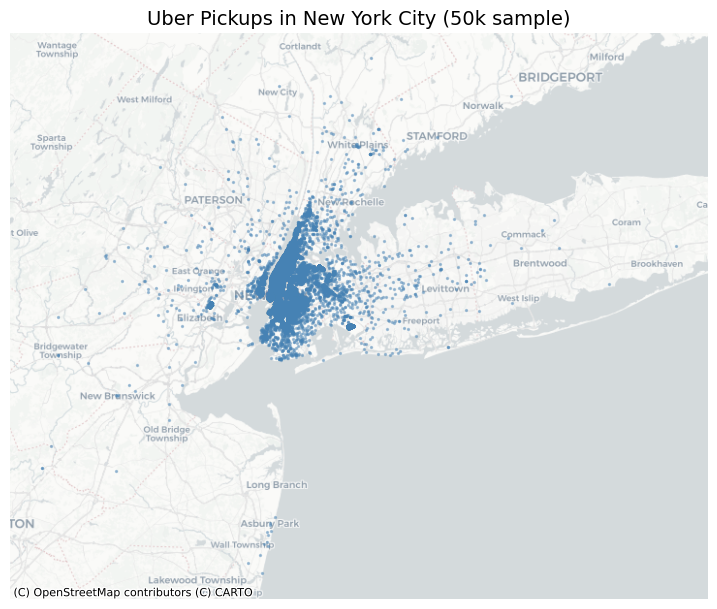

In [42]:
# Sample a subset of points (50k is plenty for map clarity)
sample = df.sample(50000, random_state=42)

# Create a GeoDataFrame from Lon/Lat
gdf = gpd.GeoDataFrame(
    sample,
    geometry=gpd.points_from_xy(sample["Lon"], sample["Lat"]),
    crs="EPSG:4326"  # coordinate system = latitude/longitude (WGS84)
)

# Convert to web mercator (needed for contextily basemap)
gdf = gdf.to_crs(epsg=3857)

# Plot points
ax = gdf.plot(figsize=(9,9), alpha=0.4, markersize=2, color="steelblue")

# Add OpenStreetMap background
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

# Tidy up
ax.set_axis_off()
plt.title("Uber Pickups in New York City (50k sample)", fontsize=14)
plt.show()


### Pickup Density Heatmap (Sample 100k)

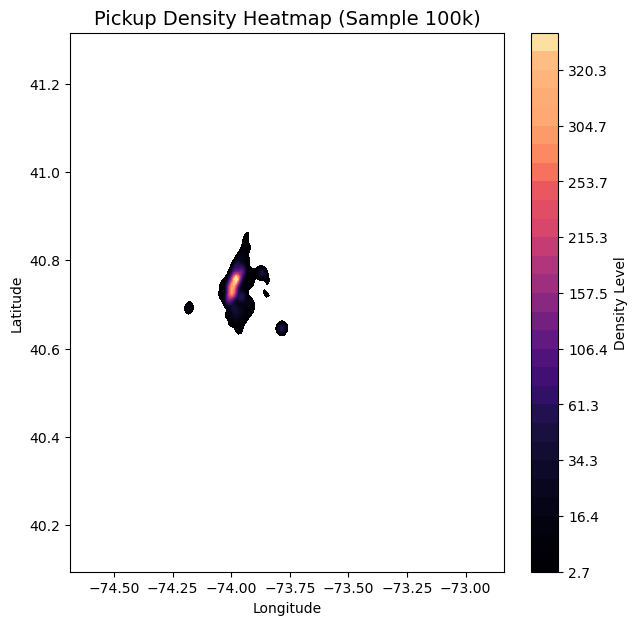

In [17]:
# Create the figure
plt.figure(figsize=(7,7))

# Draw the KDE heatmap
ax = sns.kdeplot(
    x=df["Lon"].sample(100_000, random_state=42),
    y=df["Lat"].sample(100_000, random_state=42),
    cmap="magma",
    fill=True,
    thresh=0.05,
    levels=30
)

# Add title and labels
plt.title("Pickup Density Heatmap (Sample 100k)", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")

# Add colorbar legend
# Seaborn KDE returns a contour set that Matplotlib understands
cbar = plt.colorbar(ax.collections[0], ax=ax)
cbar.set_label("Density Level")

plt.show()


### Number of Pickups by Uber Base

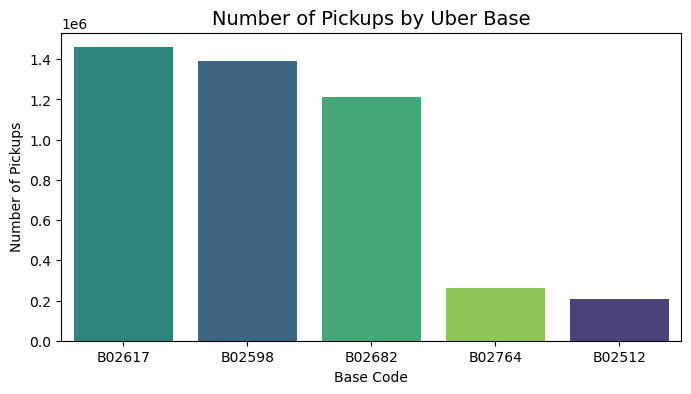

In [18]:
plt.figure(figsize=(8,4))
sns.countplot(x="Base", hue="Base", data=df, palette="viridis", order=df["Base"].value_counts().index)
plt.title("Number of Pickups by Uber Base", fontsize=14)
plt.xlabel("Base Code")
plt.ylabel("Number of Pickups")
plt.show()


# Supervised Machine Learning

## K-Means

### K-Means' Elbow

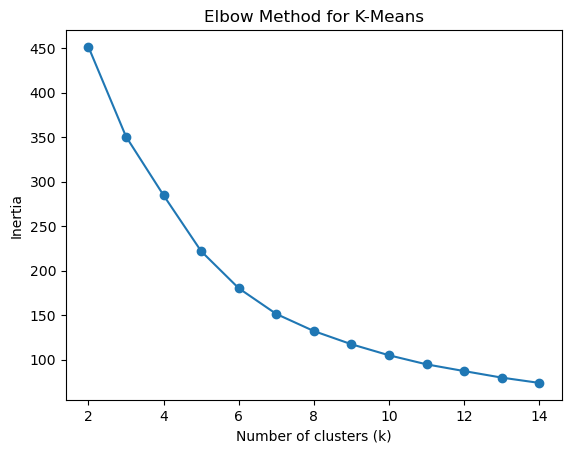

In [43]:
# Sample 100k points for clustering
X = df[["Lat", "Lon"]].sample(150000, random_state=42)

# Try different k values to pick the best one (optional step)
inertia = []
K = range(2, 15)
for k in K:
    model = KMeans(n_clusters=k, random_state=42, n_init=10)
    model.fit(X)
    inertia.append(model.inertia_)

plt.plot(K, inertia, marker="o")
plt.title("Elbow Method for K-Means")
plt.xlabel("Number of clusters (k)")
plt.ylabel("Inertia")
plt.show()


### K-Means Clusters of Uber Pickups in NYC

/var/folders/0d/cq05m_v54h79z_gtnnbhcx1w0000gn/T/ipykernel_8310/2904554117.py:38: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab10", len(unique_clusters))


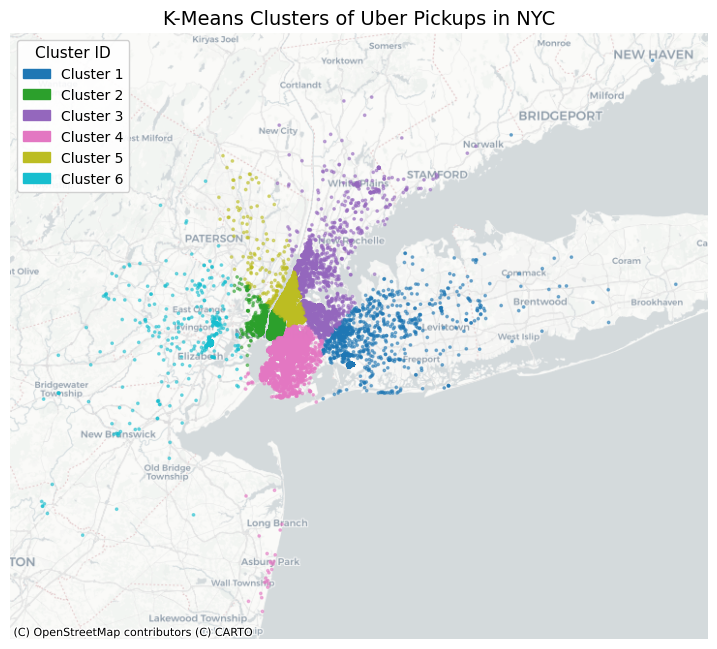

In [20]:
# Train final model
kmeans = KMeans(n_clusters=6, random_state=42, n_init=10)
labels = kmeans.fit_predict(X)

# Add cluster labels
X_plot = X.copy()
X_plot["cluster"] = labels

# Convert to GeoDataFrame
gdf_clusters = gpd.GeoDataFrame(
    X_plot,
    geometry=gpd.points_from_xy(X_plot["Lon"], X_plot["Lat"]),
    crs="EPSG:4326"
).to_crs(epsg=3857)

# Plot
fig, ax = plt.subplots(figsize=(9,9))
gdf_clusters.plot(
    ax=ax,
    column="cluster",
    cmap="tab10",
    markersize=3,
    alpha=0.5,
    legend=False  # we'll make a custom one
)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

# Clean axes
ax.set_axis_off()

# Add title
plt.title("K-Means Clusters of Uber Pickups in NYC", fontsize=14)

# Custom Legend (exact colors)
unique_clusters = sorted(gdf_clusters["cluster"].unique())
cmap = cm.get_cmap("tab10", len(unique_clusters))

# Create color patches that match the map
patches = [
    mpatches.Patch(color=cmap(i / max(1, len(unique_clusters)-1)), label=f"Cluster {i+1}")
    for i in range(len(unique_clusters))
]

plt.legend(
    handles=patches,
    title="Cluster ID",
    loc="upper left",
    frameon=True,
    facecolor="white",
    framealpha=0.9,
    fontsize=10,
    title_fontsize=11
)

plt.show()


### Silhouette Score

The Silhouette Score measures how well-separated the clusters are.

A value close to 1 indicates dense, well-separated clusters.

Around 0 means overlapping clusters.

Negative values indicate potential misclassification.

In [21]:
# For K-Means
kmeans_labels = kmeans.labels_
score_kmeans = silhouette_score(X, kmeans_labels)
print(f"Silhouette Score (K-Means): {score_kmeans:.3f}")


Silhouette Score (K-Means): 0.443


## From K-Means to DBSCAN

While **K-Means** assumes clusters are spherical and of similar size, it struggles with spatial data where cluster density and shape vary.  

To better capture the **organic, irregular distribution** of Uber pickups across New York, we now apply **DBSCAN (Density-Based Spatial Clustering)**, which identifies clusters based on local density rather than distance from a centroid.  

This approach is particularly suited for **geographical datasets**, where points may form elongated or uneven clusters along roads or neighborhoods.


## DBSCAN

eps controls how close points need to be to each other to be grouped, and min_samples defines how many nearby points are needed to form a cluster instead of being considered noise.

### DBSCAN Clusters of Uber Pickups (eps=0.01, min_samples=50)

We found 6 clusters with these settings.

Number of clusters found: 6


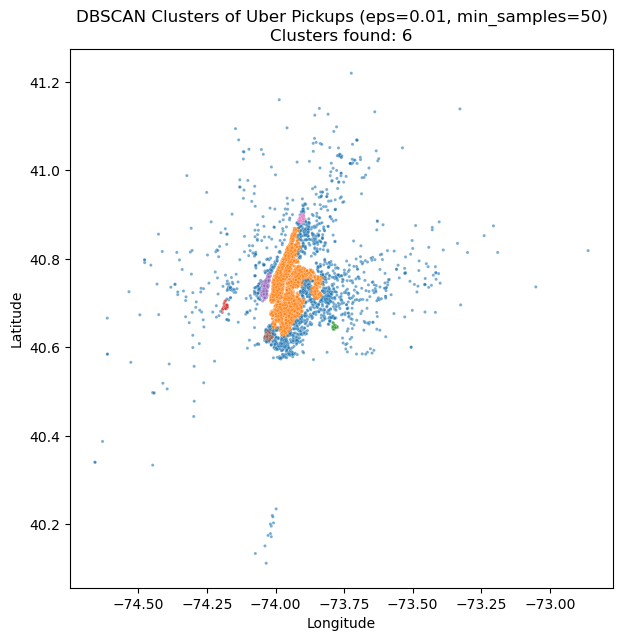

In [22]:
# Sample 50k points for DBSCAN
X = df[["Lat", "Lon"]].sample(50000, random_state=42)

# Run DBSCAN
dbscan = DBSCAN(eps=0.01, min_samples=50)  # you can adjust eps
labels = dbscan.fit_predict(X)

# Add labels to data
X_plot = X.copy()
X_plot["cluster"] = labels

# Quick look at the number of clusters found
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(f"Number of clusters found: {n_clusters}")

# Plot
plt.figure(figsize=(7,7))
sns.scatterplot(
    x="Lon",
    y="Lat",
    hue="cluster",
    data=X_plot,
    palette="tab10",
    s=5,
    alpha=0.6,
    legend=False
)
plt.title(f"DBSCAN Clusters of Uber Pickups (eps=0.01, min_samples=50)\nClusters found: {n_clusters}")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

### Silhouette Score

In [23]:
# For DBSCAN (ignore noise points with label = -1)
dbscan_labels = dbscan.labels_
mask = dbscan_labels != -1
if mask.sum() > 1:
    score_dbscan = silhouette_score(X[mask], dbscan_labels[mask])
    print(f"Silhouette Score (DBSCAN): {score_dbscan:.3f}")
else:
    print("DBSCAN produced too few clusters for a valid silhouette score.")

Silhouette Score (DBSCAN): 0.230


### Choose the best eps

This plot shows the distance to each point’s 5th nearest neighbor, sorted in ascending order. The “elbow” (the point where the curve sharply increases) indicates a good value for eps, as it separates dense regions from sparser areas.

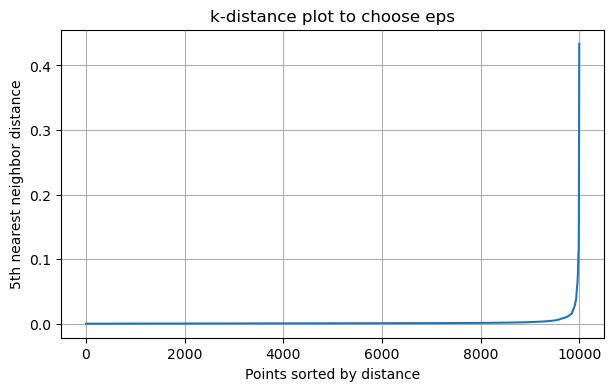

In [24]:
# Sample subset
X = df[["Lat", "Lon"]].sample(10000, random_state=42)

# Fit NearestNeighbors to compute distances
nbrs = NearestNeighbors(n_neighbors=5).fit(X)
distances, indices = nbrs.kneighbors(X)

# Sort distances to plot the "elbow"
distances = np.sort(distances[:,4])  # 4 = 5th nearest neighbor
plt.figure(figsize=(7,4))
plt.plot(distances)
plt.title("k-distance plot to choose eps")
plt.xlabel("Points sorted by distance")
plt.ylabel("5th nearest neighbor distance")
plt.grid(True)
plt.show()


### Zooming in

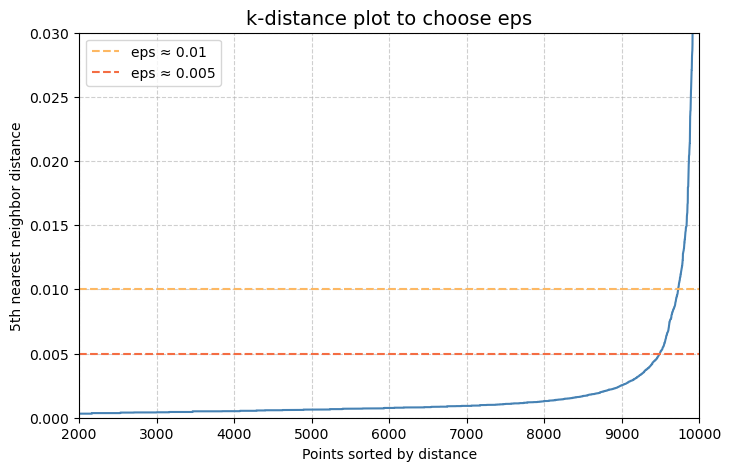

In [25]:
# Sample subset
X = df[["Lat", "Lon"]].sample(10000, random_state=42)

# Compute distances to the 5th nearest neighbor
nbrs = NearestNeighbors(n_neighbors=5).fit(X)
distances, indices = nbrs.kneighbors(X)

# Sort distances in ascending order
distances = np.sort(distances[:, 4])  # 4 = 5th neighbor

# Plot full curve
plt.figure(figsize=(8,5))
plt.plot(distances, color="steelblue")
plt.title("k-distance plot to choose eps", fontsize=14)
plt.xlabel("Points sorted by distance")
plt.ylabel("5th nearest neighbor distance")
plt.grid(True, linestyle="--", alpha=0.6)

# Zoom on the elbow area (adjust xlim/ylim to your data)
plt.xlim(2000, 10000)
plt.ylim(0, 0.03)

# Add horizontal/vertical reference lines (optional)
plt.axhline(y=0.01, color="#FDB863", linestyle="--", label="eps ≈ 0.01")
plt.axhline(y=0.005, color="#F46D43", linestyle="--", label="eps ≈ 0.005")
plt.legend()
plt.show()


### DBSCAN Clusters of Uber Pickups (eps=0.005, min_samples=50)

We found 13 clusters with these settings, which seems too much.

Number of clusters found: 13


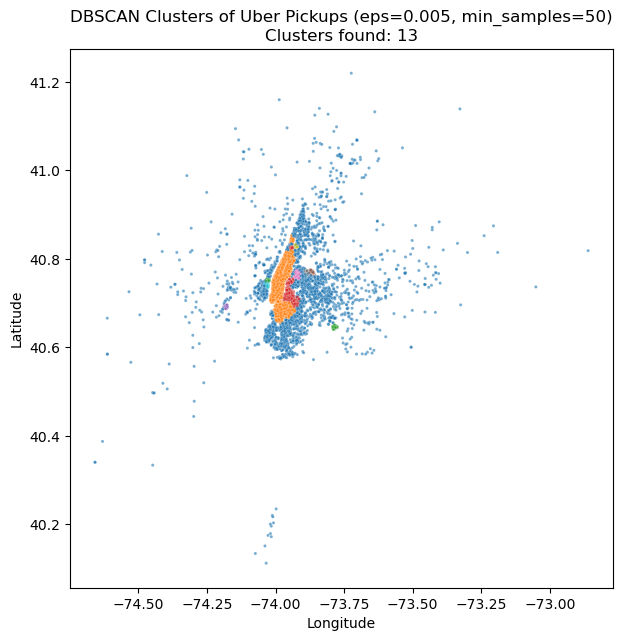

In [26]:
# Sample 50k points for DBSCAN
X = df[["Lat", "Lon"]].sample(50000, random_state=42)

# Run DBSCAN
dbscan = DBSCAN(eps=0.005, min_samples=50)  # you can adjust eps
labels = dbscan.fit_predict(X)

# Add labels to data
X_plot = X.copy()
X_plot["cluster"] = labels

# Quick look at the number of clusters found
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(f"Number of clusters found: {n_clusters}")

# Plot
plt.figure(figsize=(7,7))
sns.scatterplot(
    x="Lon",
    y="Lat",
    hue="cluster",
    data=X_plot,
    palette="tab10",
    s=5,
    alpha=0.6,
    legend=False
)
plt.title(f"DBSCAN Clusters of Uber Pickups (eps=0.005, min_samples=50)\nClusters found: {n_clusters}")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

### Silhouette Score

In [27]:
# For DBSCAN (ignore noise points with label = -1)
dbscan_labels = dbscan.labels_
mask = dbscan_labels != -1
if mask.sum() > 1:
    score_dbscan = silhouette_score(X[mask], dbscan_labels[mask])
    print(f"Silhouette Score (DBSCAN): {score_dbscan:.3f}")
else:
    print("DBSCAN produced too few clusters for a valid silhouette score.")

Silhouette Score (DBSCAN): 0.126


### Trying three different "eps"

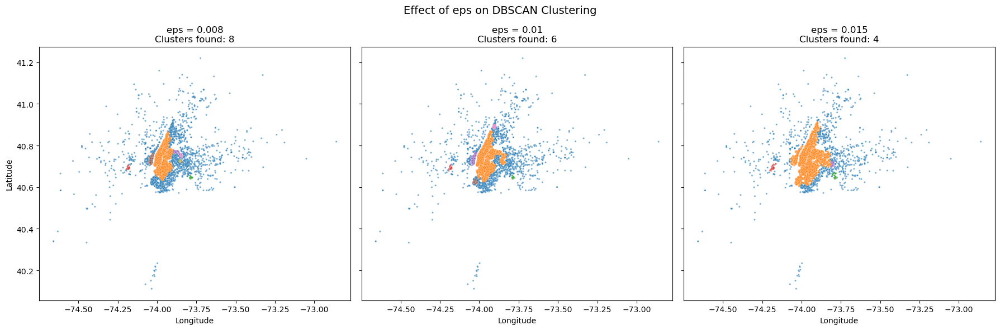

In [28]:
# Sample a manageable subset
X = df[["Lat", "Lon"]].sample(50000, random_state=42)

# Try different eps values
eps_values = [0.008, 0.01, 0.015]
min_samples = 50

fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharex=True, sharey=True)

for i, eps in enumerate(eps_values):
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    labels = dbscan.fit_predict(X)

    # Count how many clusters (excluding noise)
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

    sns.scatterplot(
        x="Lon",
        y="Lat",
        hue=labels,
        data=X.assign(cluster=labels),
        palette="tab10",
        s=5,
        alpha=0.6,
        legend=False,
        ax=axes[i]
    )

    axes[i].set_title(f"eps = {eps}\nClusters found: {n_clusters}", fontsize=12)
    axes[i].set_xlabel("Longitude")
    axes[i].set_ylabel("Latitude")

plt.suptitle("Effect of eps on DBSCAN Clustering", fontsize=14)
plt.tight_layout()
plt.show()


### DBSCAN Clusters of Uber Pickups (eps=0.009, min_samples=50)

We found 6 clusters with eps = 0.009

Number of clusters found: 6


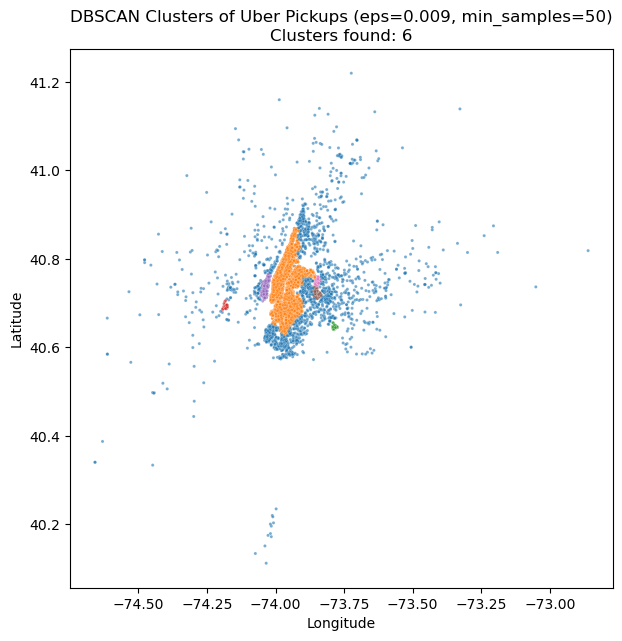

In [29]:
# Sample 50k points for DBSCAN
X = df[["Lat", "Lon"]].sample(50000, random_state=42)

# Run DBSCAN
dbscan = DBSCAN(eps=0.009, min_samples=50)  # you can adjust eps
labels = dbscan.fit_predict(X)

# Add labels to data
X_plot = X.copy()
X_plot["cluster"] = labels

# Quick look at the number of clusters found
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
print(f"Number of clusters found: {n_clusters}")

# Plot
plt.figure(figsize=(7,7))
sns.scatterplot(
    x="Lon",
    y="Lat",
    hue="cluster",
    data=X_plot,
    palette="tab10",
    s=5,
    alpha=0.6,
    legend=False
)
plt.title(f"DBSCAN Clusters of Uber Pickups (eps=0.009, min_samples=50)\nClusters found: {n_clusters}")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

### Silhouette Score

In [30]:
# For DBSCAN (ignore noise points with label = -1)
dbscan_labels = dbscan.labels_
mask = dbscan_labels != -1
if mask.sum() > 1:
    score_dbscan = silhouette_score(X[mask], dbscan_labels[mask])
    print(f"Silhouette Score (DBSCAN): {score_dbscan:.3f}")
else:
    print("DBSCAN produced too few clusters for a valid silhouette score.")

Silhouette Score (DBSCAN): 0.229


### Compare the "min-sample"

We are validating an optimal min_sample at 50 for 6 clusters.

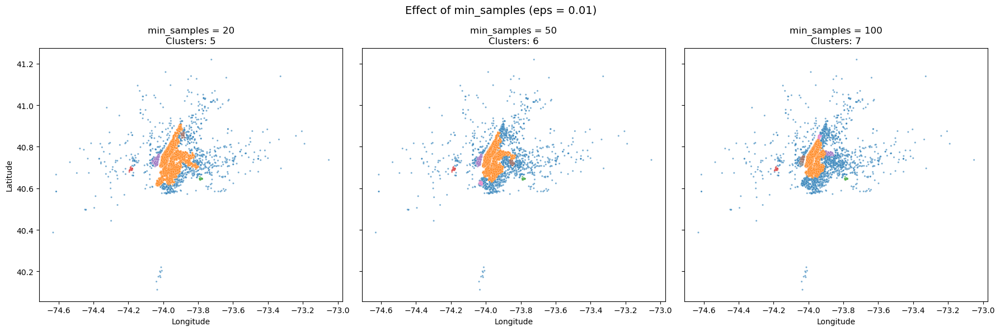

In [31]:
# Subset
X = df[["Lat", "Lon"]].sample(40000, random_state=42)

eps = 0.01
min_samples_values = [20, 50, 100]

fig, axes = plt.subplots(1, 3, figsize=(18,6), sharex=True, sharey=True)

for i, ms in enumerate(min_samples_values):
    db = DBSCAN(eps=eps, min_samples=ms)
    labels = db.fit_predict(X)
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

    sns.scatterplot(
        x="Lon", y="Lat",
        hue=labels,
        data=X.assign(cluster=labels),
        palette="tab10",
        s=5, alpha=0.6,
        legend=False, ax=axes[i]
    )
    axes[i].set_title(f"min_samples = {ms}\nClusters: {n_clusters}", fontsize=12)
    axes[i].set_xlabel("Longitude")
    axes[i].set_ylabel("Latitude")

plt.suptitle(f"Effect of min_samples (eps = {eps})", fontsize=14)
plt.tight_layout()
plt.show()


### View with the map in the background

We are validating an optimal eps at 0.01 and 50 min_sample.

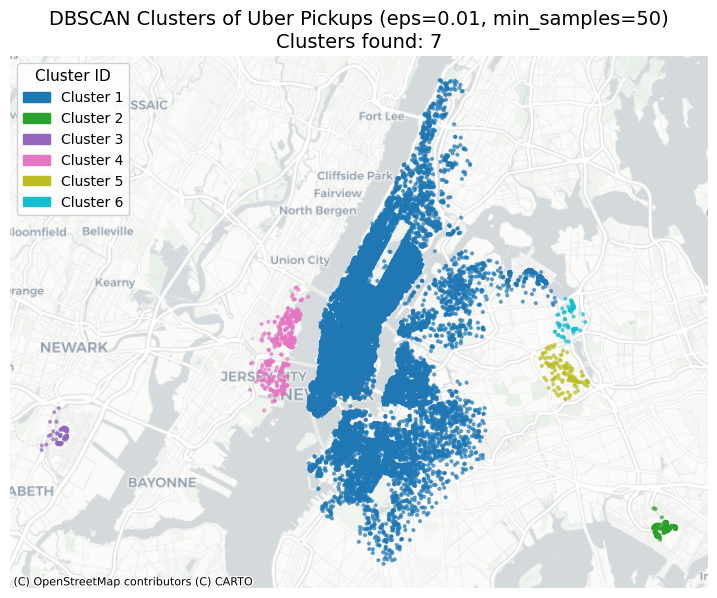

In [32]:
# Convert to GeoDataFrame
gdf_dbscan = gpd.GeoDataFrame(
    X_plot,
    geometry=gpd.points_from_xy(X_plot["Lon"], X_plot["Lat"]),
    crs="EPSG:4326"
).to_crs(epsg=3857)

# --- Plot ---
fig, ax = plt.subplots(figsize=(9,9))
gdf_dbscan[gdf_dbscan["cluster"] != -1].plot(
    ax=ax,
    column="cluster",
    cmap="tab10",
    markersize=4,
    alpha=0.6,
    legend=False
)

# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

# Clean axes and title
ax.set_axis_off()
plt.title(
    f"DBSCAN Clusters of Uber Pickups (eps=0.01, min_samples=50)\nClusters found: {n_clusters}",
    fontsize=14
)

# --- Correct legend ---
unique_clusters = sorted([c for c in gdf_dbscan["cluster"].unique() if c != -1])
cmap = mpl.colormaps["tab10"]

# Build legend with exact same colors as map
patches = []
for i, cluster in enumerate(unique_clusters):
    # La couleur correspond à l’index réel du cluster (i / nb de clusters)
    color = cmap(i / max(1, len(unique_clusters) - 1))
    patches.append(mpatches.Patch(color=color, label=f"Cluster {i+1}"))

# Add legend
plt.legend(
    handles=patches,
    title="Cluster ID",
    loc="upper left",
    frameon=True,
    facecolor="white",
    framealpha=0.9,
    fontsize=10,
    title_fontsize=11
)

plt.show()


### Silhouette Score

In [33]:
# For DBSCAN (ignore noise points with label = -1)
dbscan_labels = dbscan.labels_
mask = dbscan_labels != -1

# Important: use X_plot, not the full X
X_dbscan = X_plot[["Lat", "Lon"]].values  # same 40k sample used for DBSCAN

if mask.sum() > 1 and len(set(dbscan_labels[mask])) > 1:
    score_dbscan = silhouette_score(X_dbscan[mask], dbscan_labels[mask])
    print(f"Silhouette Score (DBSCAN): {score_dbscan:.3f}")
else:
    print("DBSCAN produced too few clusters for a valid silhouette score.")


Silhouette Score (DBSCAN): 0.229


### Interpreting the Silhouette Score for DBSCAN

The **Silhouette Score** obtained for DBSCAN is around **0.23**.  
While this might appear relatively low compared to classical clustering tasks,  
it is **typical and acceptable for spatial, real-world data** like Uber pickup locations.

Unlike K-Means, which assumes compact and spherical clusters,  
**DBSCAN** forms clusters based on *density continuity*.  
As a result, the clusters can have **irregular shapes** and **uneven densities**,  
which naturally lowers the Silhouette Score — even when the clusters are meaningful.

In this context, the score indicates that:
- the clusters are **partially overlapping** in transition areas (e.g., between Midtown and Downtown),  
- but **clear density zones still exist**, corresponding to key activity areas such as Manhattan, Brooklyn, and airports.

> Therefore, a Silhouette Score around 0.23 is consistent with a valid and interpretable DBSCAN result,  
> confirming the presence of **distinct but spatially connected Uber demand zones** across New York City.


### Different time periods

Weekday Morning (6–9AM): 7 clusters detected


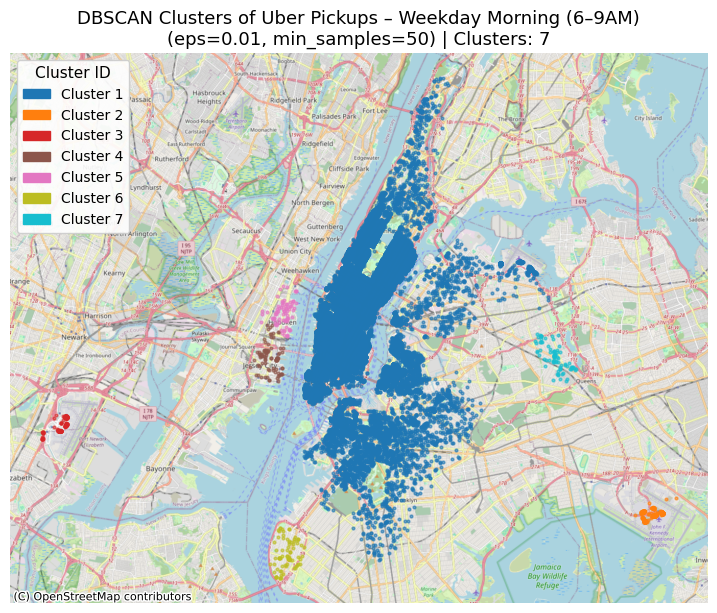

Weekday Evening (4–7PM): 6 clusters detected


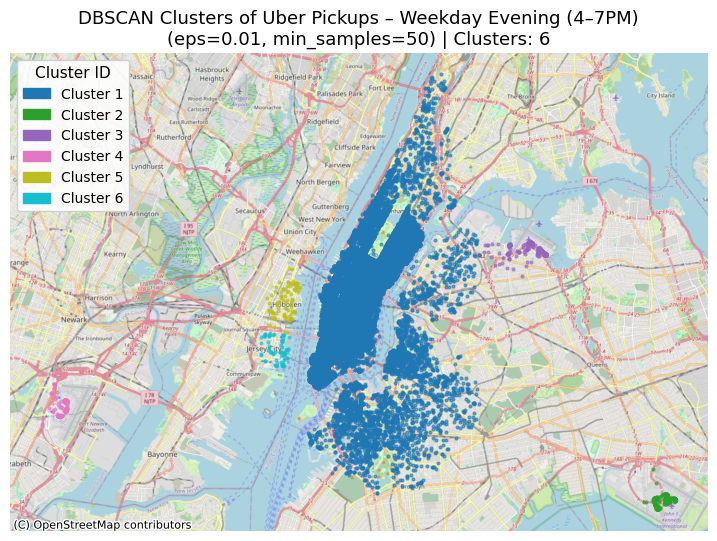

Saturday Evening (4–10PM): 7 clusters detected


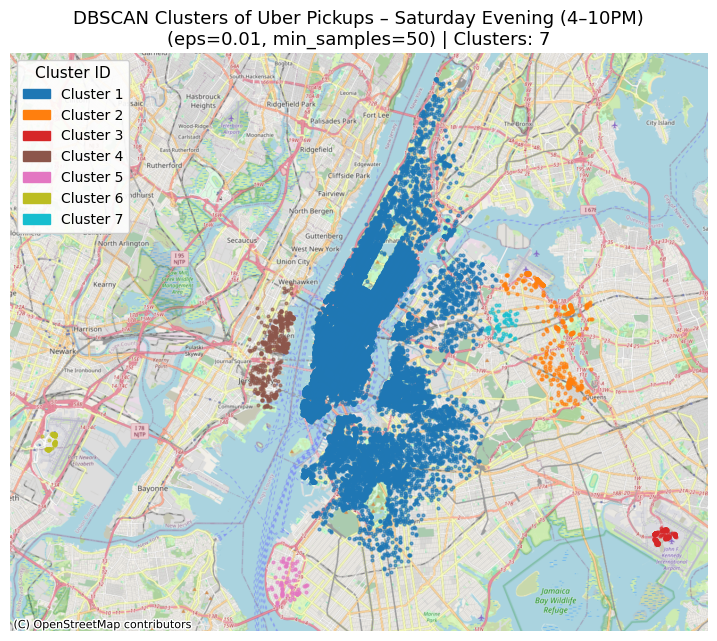

In [34]:
# Define time periods
time_periods = {
    "Weekday Morning (6–9AM)": (["Monday", "Tuesday", "Wednesday", "Thursday", "Friday"], range(6, 10)),
    "Weekday Evening (4–7PM)": (["Monday", "Tuesday", "Wednesday", "Thursday", "Friday"], range(16, 20)),
    "Saturday Evening (4–10PM)": (["Saturday"], range(16, 23))
}

for label, (days, hours) in time_periods.items():
    subset = df[(df["weekday"].isin(days)) & (df["hour"].isin(hours))]
    X = subset[["Lat", "Lon"]].sample(40000, random_state=42)

    dbscan = DBSCAN(eps=0.01, min_samples=50)
    labels = dbscan.fit_predict(X)

    X_plot = X.copy()
    X_plot["cluster"] = labels

    unique_clusters = sorted([c for c in set(labels) if c != -1])
    n_clusters = len(unique_clusters)
    print(f"{label}: {n_clusters} clusters detected")

    gdf = gpd.GeoDataFrame(
        X_plot,
        geometry=gpd.points_from_xy(X_plot["Lon"], X_plot["Lat"]),
        crs="EPSG:4326"
    ).to_crs(epsg=3857)

    # ---- Color mapping coherent with GeoPandas ----
    cmap = mpl.colormaps["tab10"]
    color_dict = {c: cmap(i / max(1, len(unique_clusters)-1)) for i, c in enumerate(unique_clusters)}

    # Plot
    fig, ax = plt.subplots(figsize=(9, 9))
    for c in unique_clusters:
        color = color_dict[c]
        gdf[gdf["cluster"] == c].plot(ax=ax, color=color, markersize=4, alpha=0.6)

    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, zoom=12)
    ax.set_axis_off()
    plt.title(
        f"DBSCAN Clusters of Uber Pickups – {label}\n"
        f"(eps=0.01, min_samples=50) | Clusters: {n_clusters}",
        fontsize=13
    )

    # Legend with exact same colors
    patches = [
        mpatches.Patch(color=color_dict[c], label=f"Cluster {i+1}")
        for i, c in enumerate(unique_clusters)
    ]
    plt.legend(
        handles=patches,
        title="Cluster ID",
        loc="upper left",
        frameon=True,
        facecolor="white",
        framealpha=0.9,
        fontsize=10,
        title_fontsize=11
    )

    plt.show()


Interpretation of Temporal Clusters

The three maps above highlight how Uber pickup activity in New York City changes across different time periods.

During weekday mornings (6–9AM), clusters are more dispersed across residential neighborhoods and major entry routes into Manhattan, reflecting commuter traffic as people travel to work.

In contrast, weekday evenings (4–7PM) show denser and more centralized clusters in Midtown, Downtown, and near major transit hubs such as Grand Central and Penn Station, indicating return commutes and after-work mobility.

Finally, the Saturday evening (4–10PM) clusters shift toward entertainment and leisure areas — such as SoHo, the East Village, and Brooklyn — as well as the airports (JFK and LaGuardia), reflecting nightlife and travel patterns.

These temporal variations confirm that Uber’s demand hotspots are highly dynamic:
they depend not only on location, but also on the day of the week and the time of day, following the rhythm of the city’s social and professional life.

DBSCAN successfully detected natural high-density areas of Uber pickups in New York. The main clusters correspond to urban centers such as Midtown and Downtown Manhattan, as well as major airports (JFK, LaGuardia). Points labeled as -1 represent sparse or isolated pickups outside these zones.

### Conclusion

Through this analysis, we applied unsupervised learning techniques to explore Uber pickup patterns in New York City during 2014.
Starting with a temporal exploration, we observed strong daily and weekly patterns:

clear commuting peaks during weekday mornings and evenings,

and higher late-night activity during weekends.

Spatially, K-Means revealed major pickup zones that align with real-world locations such as Midtown Manhattan, Downtown, and JFK Airport.
However, because K-Means forces clusters into circular shapes, we complemented the analysis with DBSCAN, which adapts to the city’s irregular density.
DBSCAN successfully identified natural high-density regions — the main urban areas and airports — while correctly classifying isolated pickups as noise.

This combination of temporal and spatial analysis highlights how Uber activity reflects human mobility habits: work-related movements during weekdays and leisure-driven rides at night and on weekends.

### "Folium" map for zooming

In [35]:


# 1️⃣ Take a sample for performance (Folium is slow above 20–30k points)
sample = X_plot.sample(10000, random_state=42)

# 2️⃣ Define colors for each cluster
unique_clusters = sorted(sample["cluster"].unique())
colormap = cm.get_cmap("tab10", len(unique_clusters))
cluster_colors = {c: colors.rgb2hex(colormap(i)[:3]) for i, c in enumerate(unique_clusters)}

# 3️⃣ Create the base map centered on NYC
m = folium.Map(location=[40.75, -73.98], zoom_start=11, tiles="CartoDB positron")

# 4️⃣ Add cluster points
for _, row in sample.iterrows():
    cluster_id = row["cluster"]
    color = cluster_colors.get(cluster_id, "#999999")  # grey for noise (-1)
    folium.CircleMarker(
        location=[row["Lat"], row["Lon"]],
        radius=2,
        color=color,
        fill=True,
        fill_opacity=0.6,
        opacity=0.6,
    ).add_to(m)

# 5️⃣ Add a legend (HTML overlay)
legend_html = """
<div style="
    position: fixed;
    bottom: 30px; left: 30px; width: 200px;
    background-color: white; border:2px solid grey; z-index:9999;
    font-size:12px; padding:10px;">
<b>DBSCAN Clusters</b><br>
<span style='color:#999999;'>●</span> Noise (-1)<br>
""" + "".join([
    f"<span style='color:{cluster_colors[c]};'>●</span> Cluster {c}<br>" for c in unique_clusters if c != -1
]) + "</div>"

m.get_root().html.add_child(folium.Element(legend_html))

# 6️⃣ Save and open the map
m.save("uber_dbscan_clusters_map.html")
print("✅ Map saved as 'uber_dbscan_clusters_map.html' — open it in your browser to explore interactively!")


/var/folders/0d/cq05m_v54h79z_gtnnbhcx1w0000gn/T/ipykernel_8310/3127494845.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = cm.get_cmap("tab10", len(unique_clusters))


✅ Map saved as 'uber_dbscan_clusters_map.html' — open it in your browser to explore interactively!


## Map Animation

In [36]:
# Sample for performance
df_sample = df.sample(200000, random_state=42)

# Ensure hour is numeric and sorted
df_sample["hour"] = df_sample["hour"].astype(int)
df_sample = df_sample.sort_values("hour")

# Create animation
fig = px.scatter_mapbox(
    df_sample,
    lat="Lat",
    lon="Lon",
    color="hour",
    color_continuous_scale="magma",
    size_max=6,
    zoom=9,
    animation_frame="hour",
    title="Animated Uber Pickups Hot Zones by Hour (NYC, April–September 2014)",
    height=700,
    range_color=[0, 23]  # fix color scale
)

fig.update_layout(
    mapbox_style="carto-positron",
    margin={"r":0, "t":50, "l":0, "b":0},
    coloraxis_colorbar=dict(title="Hour of Day")
)

fig.show()


## Map Animation with Clusters

### Visualizing Temporal Dynamics of Uber Pickups by Cluster

In this section, the DBSCAN model is applied once to the entire Uber dataset (using all pickup coordinates) to identify spatially dense zones of activity across New York City. Each pickup point is then associated with the hour of the day it occurred, allowing us to visualize how these same geographic clusters evolve over time.

This approach differs from running a separate clustering for each hour: instead, it preserves the same cluster structure (the same locations) and simply shows how their activity intensity changes throughout the day.

By animating the DBSCAN clusters across the 24 hours, we can observe meaningful temporal patterns:
- Early morning pickups are more dispersed in residential areas (e.g., Brooklyn, Queens, Newark).  
- During the day, activity concentrates in business districts like Midtown Manhattan.  
- In the evening, clusters near airports and nightlife areas become dominant.  

This global-then-temporal method provides a consistent spatial reference to analyze the daily rhythm of Uber demand in New York City.


In [37]:
# Use the full dataset (or a large sample for performance)
X = df[["Lat", "Lon"]].sample(150000, random_state=42)

# Run DBSCAN again
dbscan = DBSCAN(eps=0.01, min_samples=50)
labels = dbscan.fit_predict(X)

# Create DataFrame with clusters
X_plot = X.copy()
X_plot["cluster"] = labels

# Add hour information from df
X_plot["hour"] = df.loc[X_plot.index, "hour"]


In [38]:
# Copy dataset and clean
df_clustered = X_plot.copy()
df_clustered = df_clustered[df_clustered["cluster"] != -1]

# Ensure clusters start at 1
df_clustered["cluster"] = df_clustered["cluster"].astype(int) + 1

# --- Force hours as string but sorted numerically ---
df_clustered["hour"] = df_clustered["hour"].astype(int)
df_clustered = df_clustered[df_clustered["hour"].between(0, 23)]
df_clustered["hour_str"] = df_clustered["hour"].astype(str).str.zfill(2)  # "00", "01", ..., "23"
hour_order = [f"{h:02d}" for h in range(24)]  # ensure exact order

# Sort clusters and hours
df_clustered = df_clustered.sort_values(["cluster", "hour"])

# Convert cluster IDs to string for discrete color legend
df_clustered["cluster"] = df_clustered["cluster"].astype(str)

# Sample for performance
df_clustered = df_clustered.sample(min(100000, len(df_clustered)), random_state=42)

# Create animation
fig = px.scatter_mapbox(
    df_clustered,
    lat="Lat",
    lon="Lon",
    color="cluster",
    animation_frame="hour_str",   # 👈 use the padded string version
    category_orders={
        "cluster": sorted(df_clustered["cluster"].unique(), key=lambda x: int(x)),
        "hour_str": hour_order
    },
    color_discrete_sequence=px.colors.qualitative.Set1,
    zoom=9,
    title="Evolution of Uber Pickup Clusters by Hour (DBSCAN)",
    height=700
)

fig.update_layout(
    mapbox_style="carto-positron",
    margin={"r":0, "t":50, "l":0, "b":0},
    legend_title_text="Cluster ID",
    legend=dict(
        title_font=dict(size=11),
        font=dict(size=10),
        itemsizing="constant",
        yanchor="top",
        y=1.02,
        xanchor="left",
        x=0.01
    )
)

fig.write_html("uber_clusters_animation.html")


fig.show()


## Final Insights & Recommendations

This analysis explored Uber pickup patterns in New York City using **unsupervised learning** techniques  
to identify the main **spatial and temporal structures** of demand.

### 1. Clustering Insights
Two clustering approaches were applied:
- **K-Means** provided a simple segmentation of the city into large, compact regions of activity.  
  It served as a first step to visualize the overall structure of Uber pickups.  
- **DBSCAN**, being density-based, revealed more **organic and irregular clusters**,  
  accurately representing the true pickup “hot zones” shaped by urban geography and population flow.

The final DBSCAN model (eps = 0.01, min_samples = 50) detected **7 major clusters**  
corresponding to key areas such as **Midtown Manhattan, Downtown, JFK Airport, LaGuardia, and Brooklyn**.  
The clusters are spatially consistent with well-known mobility hubs.

### 2. Temporal Dynamics
By associating each pickup with its hour of occurrence,  
we visualized the **daily evolution of cluster activity**:
- **Early morning (0–6h):** low activity, mainly in residential neighborhoods.  
- **Morning commute (6–9h):** strong increase around Midtown and business areas.  
- **Afternoon (12–17h):** stable density in central Manhattan.  
- **Evening (18–23h):** renewed growth near entertainment zones and airports.

The animation confirms that **demand shifts geographically throughout the day**,  
following clear socio-economic patterns (home → work → leisure → travel).

### 3. Business Implications
- Uber could **optimize driver positioning** dynamically according to time of day,  
  ensuring faster pick-ups and reduced idle time.  
- The company can **anticipate surge pricing zones** in the evening,  
  particularly around airports and nightlife districts.  
- Future work could include **temporal forecasting** (e.g. using Prophet)  
  to predict pickup density per cluster hour by hour.

### 4. Key Takeaway
Unsupervised learning effectively uncovered the **hidden structure of urban mobility**.  
While the Silhouette Score (≈ 0.23) indicates moderate separation,  
the clusters are **geographically interpretable and operationally relevant**.  

> This project demonstrates how data-driven insights can help Uber align supply with real demand,  
> improving both **driver efficiency** and **customer experience** across New York City.


# Bonus 2015

                          Zone    Borough   Pickups
160             Midtown Center  Manhattan  460732.0
230       TriBeCa/Civic Center  Manhattan  420356.0
233                   Union Sq  Manhattan  419045.0
78                East Village  Manhattan  407591.0
248               West Village  Manhattan  323989.0
229  Times Sq/Theatre District  Manhattan  315919.0
67                East Chelsea  Manhattan  299781.0
162              Midtown North  Manhattan  296734.0
169                Murray Hill  Manhattan  290550.0
131                JFK Airport     Queens  289169.0


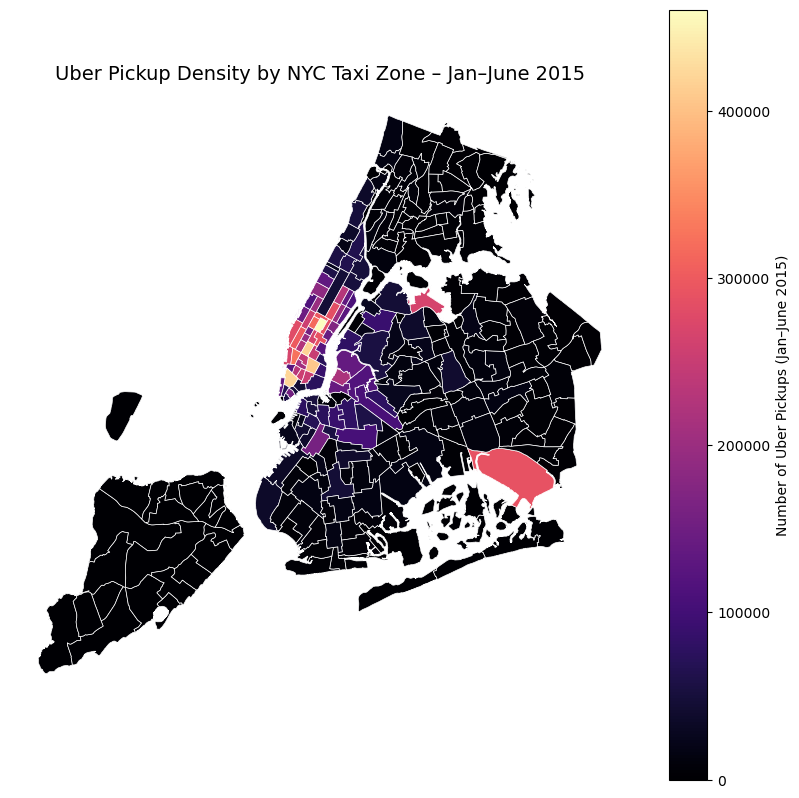

In [39]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# --- 1. Load 2015 Uber data ---
uber15 = pd.read_csv("uber-trip-data/uber-raw-data-janjune-15.csv")

# --- 2. Load taxi zones shapefile (contains geometry) ---
zones = gpd.read_file("taxi_zones/taxi_zones.shp")

# --- 3. Optional: load the lookup CSV for borough names ---
lookup = pd.read_csv("uber-trip-data/taxi-zone-lookup.csv")

# --- 4. Ensure consistent key types ---
uber15["locationID"] = uber15["locationID"].astype(int)
zones["LocationID"] = zones["LocationID"].astype(int)
lookup["LocationID"] = lookup["LocationID"].astype(int)

# --- 5. Merge Uber data with zone IDs ---
zone_counts = (
    uber15.groupby("locationID")
    .size()
    .reset_index(name="Pickups")
)

# --- 6. Merge counts with geometry + lookup info ---
zones_agg = zones.merge(zone_counts, left_on="LocationID", right_on="locationID", how="left")
zones_agg = zones_agg.merge(lookup[["LocationID", "Borough", "Zone"]], on="LocationID", how="left")
zones_agg["Pickups"] = zones_agg["Pickups"].fillna(0)

# --- 7. Top 10 most active zones ---
top10 = zones_agg[["Zone", "Borough", "Pickups"]].sort_values("Pickups", ascending=False).head(10)
print(top10)

# --- 8. Plot heatmap ---
fig, ax = plt.subplots(figsize=(10,10))
zones_agg.plot(
    ax=ax,
    column="Pickups",
    cmap="magma",
    linewidth=0.5,
    edgecolor="white",
    legend=True,
    legend_kwds={"label": "Number of Uber Pickups (Jan–June 2015)"}
)
ax.set_axis_off()
ax.set_title("Uber Pickup Density by NYC Taxi Zone – Jan–June 2015", fontsize=14)
plt.show()


### Insights from the 2015 Uber Pickup Density Map

The 2015 dataset provides an aggregated view of Uber pickups by official NYC taxi zones, using `LocationID` instead of raw GPS coordinates. By combining this data with the official taxi zone shapefile, we can visualize the spatial distribution of demand across New York City.

The results confirm and extend the 2014 findings:
- Highest pickup volumes are concentrated in Midtown and Downtown Manhattan, where business activity and tourist flow are at their peak.  
- JFK and LaGuardia airports stand out as strong outer clusters, highlighting the importance of travel-related demand.  
- Brooklyn and Queens show moderate but growing activity, indicating Uber’s continued expansion beyond Manhattan during 2015.  
- Low-density areas are mainly residential or peripheral zones (e.g. Staten Island), consistent with limited late-night pickup frequency.

The top 10 most active zones correspond to the city’s main economic and transit hubs,  
confirming Uber’s alignment with the natural mobility patterns of New Yorkers.  

Overall, the 2015 dataset complements the 2014 GPS-based analysis by offering a macro-level validation of the same spatial and economic logic: Uber demand remains strongest in Manhattan’s commercial core and around key transportation gateways.
